# Signal processing

Code from

https://github.com/RobRomijnders/LSTM_tsc/

and use data from the world largest time-series dataset archive

at http://www.cs.ucr.edu/%7Eeamonn/time_series_data/

In [5]:
import numpy as np
import os
os.environ['TF_CPP_MIN_LOG_LEVEL']='3'
import tensorflow as tf
tf.logging.set_verbosity(tf.logging.ERROR)

from tensorflow.python.framework import ops
from tensorflow.python.ops import clip_ops
from tensorflow.contrib.rnn import LSTMCell
#from tensorflow.contrib.rnn.python.ops import core_rnn
from tensorflow.contrib.rnn import static_rnn


### Utils

In [6]:
def load_data(direc,ratio,dataset):
  """Input:
  direc: location of the UCR archive
  ratio: ratio to split training and testset
  dataset: name of the dataset in the UCR archive"""
  datadir = direc + '/' + dataset + '/' + dataset
  data_train = np.loadtxt(datadir+'_TRAIN',delimiter=',')
  data_test_val = np.loadtxt(datadir+'_TEST',delimiter=',')
  DATA = np.concatenate((data_train,data_test_val),axis=0)
  N = DATA.shape[0]

  ratio = (ratio*N).astype(np.int32)
  ind = np.random.permutation(N)
  X_train = DATA[ind[:ratio[0]],1:]
  X_val = DATA[ind[ratio[0]:ratio[1]],1:]
  X_test = DATA[ind[ratio[1]:],1:]
  # Targets have labels 1-indexed. We subtract one for 0-indexed
  y_train = DATA[ind[:ratio[0]],0]-1
  y_val = DATA[ind[ratio[0]:ratio[1]],0]-1
  y_test = DATA[ind[ratio[1]:],0]-1
  return X_train,X_val,X_test,y_train,y_val,y_test


def sample_batch(X_train,y_train,batch_size):
  """ Function to sample a batch for training"""
  N,data_len = X_train.shape
  ind_N = np.random.choice(N,batch_size,replace=False)
  X_batch = X_train[ind_N]
  y_batch = y_train[ind_N]
  return X_batch,y_batch

## Create model

In [7]:
class Model():
  def __init__(self,config):
    
    num_layers = config['num_layers']
    hidden_size = config['hidden_size']
    max_grad_norm = config['max_grad_norm']
    self.batch_size = config['batch_size']
    sl = config['sl']
    learning_rate = config['learning_rate']
    num_classes = config['num_classes']
    """Place holders"""
    self.input = tf.placeholder(tf.float32, [None, sl], name = 'input')
    self.labels = tf.placeholder(tf.int64, [None], name='labels')
    self.keep_prob = tf.placeholder("float", name = 'Drop_out_keep_prob')

    with tf.name_scope("LSTM_setup") as scope:
      def single_cell():
        return tf.contrib.rnn.DropoutWrapper(LSTMCell(hidden_size),output_keep_prob=self.keep_prob)

      cell = tf.contrib.rnn.MultiRNNCell([single_cell() for _ in range(num_layers)])
      initial_state = cell.zero_state(self.batch_size, tf.float32)
    
    input_list = tf.unstack(tf.expand_dims(self.input,axis=2),axis=1)
    
    # setup the network
    outputs,_ = static_rnn(cell, input_list, dtype=tf.float32)

    output = outputs[-1]


    #Generate a classification from the last cell_output
    #Note, this is where timeseries classification differs from sequence to sequence
    #modelling. We only output to Softmax at last time step
    with tf.name_scope("Softmax") as scope:
      with tf.variable_scope("Softmax_params"):
        softmax_w = tf.get_variable("softmax_w", [hidden_size, num_classes])
        softmax_b = tf.get_variable("softmax_b", [num_classes])
      logits = tf.nn.xw_plus_b(output, softmax_w, softmax_b)
      #Use sparse Softmax because we have mutually exclusive classes
      loss = tf.nn.sparse_softmax_cross_entropy_with_logits(logits=logits,labels=self.labels,name = 'softmax')
      self.cost = tf.reduce_sum(loss) / self.batch_size
    with tf.name_scope("Evaluating_accuracy") as scope:
      correct_prediction = tf.equal(tf.argmax(logits,1),self.labels)
      self.accuracy = tf.reduce_mean(tf.cast(correct_prediction, "float"))
      h1 = tf.summary.scalar('accuracy',self.accuracy)
      h2 = tf.summary.scalar('cost', self.cost)


    """Optimizer"""
    with tf.name_scope("Optimizer") as scope:
      tvars = tf.trainable_variables()
      grads, _ = tf.clip_by_global_norm(tf.gradients(self.cost, tvars),max_grad_norm)   #We clip the gradients to prevent explosion
      optimizer = tf.train.AdamOptimizer(learning_rate)
      gradients = zip(grads, tvars)
      self.train_op = optimizer.apply_gradients(gradients)
      # Add histograms for variables, gradients and gradient norms.
      # The for-loop loops over all entries of the gradient and plots
      # a histogram. We cut of
      for gradient, variable in gradients:  #plot the gradient of each trainable variable
             if isinstance(gradient, ops.IndexedSlices):
               grad_values = gradient.values
             else:
               grad_values = gradient
             tf.summary.histogram(variable.name, variable)
             tf.summary.histogram(variable.name + "/gradients", grad_values)
             tf.summary.histogram(variable.name + "/gradient_norm", clip_ops.global_norm([grad_values]))

    #Final code for the TensorBoard
    # Merges all summaries collected in the default graph.
    self.merged = tf.summary.merge_all()
    
    self.init_op = tf.global_variables_initializer()
    print('Finished computation graph')

## Get data sets

In [15]:
import zipfile
from six.moves.urllib.request import urlretrieve

In [16]:
def download_data(zipurl):
    from io import BytesIO
    from urllib.request import urlopen
    from zipfile import ZipFile
    with urlopen(zipurl) as zipresp:
        with ZipFile(BytesIO(zipresp.read())) as zfile:
            zfile.extractall('.',pwd=b'attempttoclassify') #.encode('cp850','replace'))
    print('Finished downloading all data.')

In [15]:
# download data and unzip
# mltiple time-series data http://www.cs.ucr.edu/%7Eeamonn/time_series_data/
download_data('http://www.cs.ucr.edu/%7Eeamonn/time_series_data/UCR_TS_Archive_2015.zip')

In [17]:
!find UCR_TS_Archive_2015

UCR_TS_Archive_2015
UCR_TS_Archive_2015/Coffee
UCR_TS_Archive_2015/Coffee/Coffee_TEST
UCR_TS_Archive_2015/Coffee/Coffee_TRAIN
UCR_TS_Archive_2015/Haptics
UCR_TS_Archive_2015/Haptics/Haptics_TRAIN
UCR_TS_Archive_2015/Haptics/Haptics_TEST
UCR_TS_Archive_2015/BeetleFly
UCR_TS_Archive_2015/BeetleFly/BeetleFly_TRAIN
UCR_TS_Archive_2015/BeetleFly/BeetleFly_TEST
UCR_TS_Archive_2015/OliveOil
UCR_TS_Archive_2015/OliveOil/OliveOil_TRAIN
UCR_TS_Archive_2015/OliveOil/OliveOil_TEST
UCR_TS_Archive_2015/ECG200
UCR_TS_Archive_2015/ECG200/ECG200_TRAIN
UCR_TS_Archive_2015/ECG200/ECG200_TEST
UCR_TS_Archive_2015/SonyAIBORobotSurface
UCR_TS_Archive_2015/SonyAIBORobotSurface/SonyAIBORobotSurface_TEST
UCR_TS_Archive_2015/SonyAIBORobotSurface/SonyAIBORobotSurface_TRAIN
UCR_TS_Archive_2015/50words
UCR_TS_Archive_2015/50words/50words_TRAIN
UCR_TS_Archive_2015/50words/50words_TEST
UCR_TS_Archive_2015/SonyAIBORobotSurfaceII
UCR_TS_Archive_2015/SonyAIBORobotSurfaceII/SonyAIBORobotSurfaceII_TEST
UCR_TS_Archive_2015

## Execute main code

In [28]:
tf.reset_default_graph()

In [ ]:
%%time

"""
LSTM for time series classification
This model takes in time series and class labels.
The LSTM models the time series. A fully-connected layer
generates an output to be classified with Softmax
"""

import numpy as np
import tensorflow as tf  #TF 1.1.0rc1
tf.logging.set_verbosity(tf.logging.ERROR)
import matplotlib.pyplot as plt
# from tsc_model import Model,sample_batch,load_data,check_test #CR: if in seperate script

#Set these directories
direc = './UCR_TS_Archive_2015'
summaries_dir = './log_test1'

"""Load the data"""
ratio = np.array([0.8,0.9]) #Ratios where to split the training and validation set
X_train,X_val,X_test,y_train,y_val,y_test = load_data(direc,ratio,dataset='ChlorineConcentration')
N,sl = X_train.shape
num_classes = len(np.unique(y_train))

"""Hyperparamaters"""
batch_size = 30
max_iterations = 3000
dropout = 0.8
config = {    'num_layers' :    3,               #number of layers of stacked RNN's
              'hidden_size' :   120,             #memory cells in a layer
              'max_grad_norm' : 5,             #maximum gradient norm during training
              'batch_size' :    batch_size,
              'learning_rate' : .005,
              'sl':             sl,
              'num_classes':    num_classes}



epochs = np.floor(batch_size*max_iterations / N)
print('Train %.0f samples in approximately %d epochs' %(N,epochs))

#Instantiate a model
model = Model(config)

# to save the global step
global_step_tensor = tf.Variable(0, trainable=False, name='global_step')



"""Session time"""
sess = tf.Session() #Depending on your use, do not forget to close the session

# write events
writer = tf.summary.FileWriter(summaries_dir, sess.graph)  #writer for Tensorboard

# write ops and graph
saver = tf.train.Saver()


sess.run(model.init_op)

#for global_step_tensor initialization
ini1=tf.global_variables_initializer()
ini2=tf.local_variables_initializer()
sess.run(ini1)
sess.run(ini2)

cost_train_ma = -np.log(1/float(num_classes)+1e-9)  #Moving average training cost
acc_train_ma = 0.0
try:
  for i in range(max_iterations):
    X_batch, y_batch = sample_batch(X_train,y_train,batch_size)

    #Next line does the actual training
    cost_train, acc_train,_ = sess.run([model.cost,model.accuracy, model.train_op],feed_dict = {model.input: X_batch,model.labels: y_batch,model.keep_prob:dropout})
    cost_train_ma = cost_train_ma*0.99 + cost_train*0.01
    acc_train_ma = acc_train_ma*0.99 + acc_train*0.01
    if i%100 == 1:
    #Evaluate validation performance
      X_batch, y_batch = sample_batch(X_val,y_val,batch_size)
      cost_val, summ,acc_val = sess.run([model.cost,model.merged,model.accuracy],feed_dict = {model.input: X_batch, model.labels: y_batch, model.keep_prob:1.0})
      print('At %5.0f/%5.0f: COST %5.3f/%5.3f(%5.3f) -- Acc %5.3f/%5.3f(%5.3f)' %(i,max_iterations,cost_train,cost_val,cost_train_ma,acc_train,acc_val,acc_train_ma))
      #Write information to TensorBoard
      writer.add_summary(summ, i)
      writer.flush()
    
    increment_global_step = tf.assign_add(global_step_tensor,1,name = 'increment_global_step')
    sess.run([increment_global_step])
    #global_step=tf.train.global_step(sess, global_step_tensor)
    
    #save model to disk: create checkpoint file every 500 models
    print('global_step: %s' % global_step_tensor)
    if i%1 == 1:
        print("test1")
        save_path = saver.save(sess, summaries_dir+"/model.ckpt",global_step=global_step_tensor)

except KeyboardInterrupt:
  pass
  
epoch = float(i)*batch_size/N
print('Trained %.1f epochs, accuracy is %5.3f and cost is %5.3f'%(epoch,acc_val,cost_val))

#now run in your terminal:
# $ tensorboard --logdir = <summaries_dir>
# Replace <summaries_dir> with your own dir



Train 3445 samples in approximately 26 epochs


In [26]:
!ls

log_test1  UCR_TS_Archive_2015


In [41]:
!cat log_tb/checkpoint

model_checkpoint_path: "model.ckpt"
all_model_checkpoint_paths: "model.ckpt"


## Process results/output

In [2]:
#events
!rm -rf log_tb

In [4]:
!rm -rf log_test1

In [1]:
# Scope is Evaluating_accuracy

In [26]:
i=0
accuracy=[]
for event in tf.train.summary_iterator('log_tb/events.out.tfevents.1519596143.notebook-conda4x162cd9fdd3de1d4bee8748da9b591d0215-7565622w01ck'):
    #print(event.summary)
    i+=1
    print('## EVENT NUMBER ',i)
    for v in event.summary.value:
        print(v.tag,v.simple_value)
        if 'Evaluating_accuracy/accuracy' in v.tag:
            accuracy.append(v.simple_value)

## EVENT NUMBER  1
## EVENT NUMBER  2
## EVENT NUMBER  3
## EVENT NUMBER  4
Evaluating_accuracy/accuracy 0.6000000238418579
Evaluating_accuracy/cost 2.055257558822632
## EVENT NUMBER  5
Evaluating_accuracy/accuracy 0.5
Evaluating_accuracy/cost 1.0109885931015015
## EVENT NUMBER  6
Evaluating_accuracy/accuracy 0.5666666626930237
Evaluating_accuracy/cost 0.9924545884132385
## EVENT NUMBER  7
Evaluating_accuracy/accuracy 0.6000000238418579
Evaluating_accuracy/cost 0.9495332837104797
## EVENT NUMBER  8
Evaluating_accuracy/accuracy 0.4000000059604645
Evaluating_accuracy/cost 1.084275484085083
## EVENT NUMBER  9
Evaluating_accuracy/accuracy 0.36666667461395264
Evaluating_accuracy/cost 1.1547844409942627
## EVENT NUMBER  10
Evaluating_accuracy/accuracy 0.36666667461395264
Evaluating_accuracy/cost 1.1738938093185425
## EVENT NUMBER  11
Evaluating_accuracy/accuracy 0.7666666507720947
Evaluating_accuracy/cost 0.8116750121116638
## EVENT NUMBER  12
Evaluating_accuracy/accuracy 0.699999988079071
E

<IPython.core.display.Javascript object>


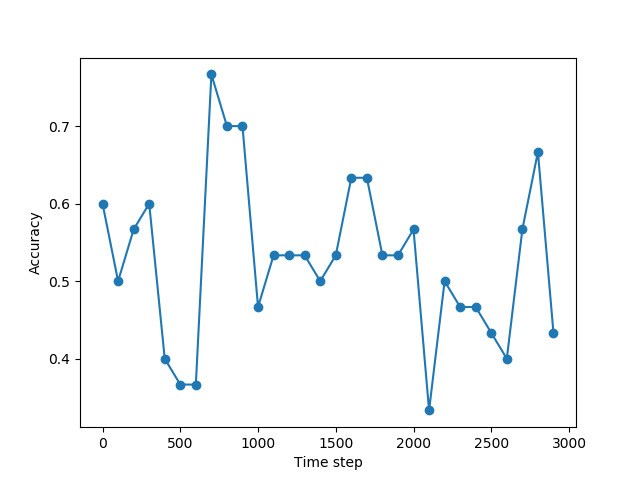

Text(0,0.5,'Accuracy')

In [30]:
import matplotlib.pyplot as plt
%matplotlib nbagg
plt.plot(100*np.array(range(len(accuracy))),accuracy,marker='o')
plt.xlabel('Time step');plt.ylabel('Accuracy')

## Checkpoint data (snapshot)

In [7]:
#sets automatically default graph (used for graph plotting below)
saver = tf.train.import_meta_graph('log_tb/model.ckpt.meta')
# in session
#saver.restore(sess,tf.train.latest_checkpoint('log_tb'))

In [11]:
from tensorflow.python.tools import inspect_checkpoint as chkp
chkp.print_tensors_in_checkpoint_file("log_tb/model.ckpt", tensor_name='', all_tensors=False)

Optimizer/beta1_power (DT_FLOAT) []
Optimizer/beta2_power (DT_FLOAT) []
Softmax_params/softmax_b (DT_FLOAT) [3]
Softmax_params/softmax_b/Adam (DT_FLOAT) [3]
Softmax_params/softmax_b/Adam_1 (DT_FLOAT) [3]
Softmax_params/softmax_w (DT_FLOAT) [120,3]
Softmax_params/softmax_w/Adam (DT_FLOAT) [120,3]
Softmax_params/softmax_w/Adam_1 (DT_FLOAT) [120,3]
rnn/multi_rnn_cell/cell_0/lstm_cell/bias (DT_FLOAT) [480]
rnn/multi_rnn_cell/cell_0/lstm_cell/bias/Adam (DT_FLOAT) [480]
rnn/multi_rnn_cell/cell_0/lstm_cell/bias/Adam_1 (DT_FLOAT) [480]
rnn/multi_rnn_cell/cell_0/lstm_cell/kernel (DT_FLOAT) [121,480]
rnn/multi_rnn_cell/cell_0/lstm_cell/kernel/Adam (DT_FLOAT) [121,480]
rnn/multi_rnn_cell/cell_0/lstm_cell/kernel/Adam_1 (DT_FLOAT) [121,480]
rnn/multi_rnn_cell/cell_1/lstm_cell/bias (DT_FLOAT) [480]
rnn/multi_rnn_cell/cell_1/lstm_cell/bias/Adam (DT_FLOAT) [480]
rnn/multi_rnn_cell/cell_1/lstm_cell/bias/Adam_1 (DT_FLOAT) [480]
rnn/multi_rnn_cell/cell_1/lstm_cell/kernel (DT_FLOAT) [240,480]
rnn/multi_rn

#### plot graph

In [4]:
from IPython.display import clear_output, Image, display, HTML

def strip_consts(graph_def, max_const_size=32):
    """Strip large constant values from graph_def."""
    strip_def = tf.GraphDef()
    for n0 in graph_def.node:
        n = strip_def.node.add() 
        n.MergeFrom(n0)
        if n.op == 'Const':
            tensor = n.attr['value'].tensor
            size = len(tensor.tensor_content)
            if size > max_const_size:
                tensor.tensor_content = "<stripped %d bytes>"%size
    return strip_def

def show_graph(graph_def, max_const_size=32):
    """Visualize TensorFlow graph."""
    if hasattr(graph_def, 'as_graph_def'):
        graph_def = graph_def.as_graph_def()
    strip_def = strip_consts(graph_def, max_const_size=max_const_size)
    code = """
        <script>
          function load() {{
            document.getElementById("{id}").pbtxt = {data};
          }}
        </script>
        <link rel="import" href="https://tensorboard.appspot.com/tf-graph-basic.build.html" onload=load()>
        <div style="height:600px">
          <tf-graph-basic id="{id}"></tf-graph-basic>
        </div>
    """.format(data=repr(str(strip_def)), id='graph'+str(np.random.rand()))

    iframe = """
        <iframe seamless style="width:1200px;height:620px;border:0" srcdoc="{}"></iframe>
    """.format(code.replace('"', '&quot;'))
    display(HTML(iframe))

In [5]:
show_graph(tf.get_default_graph().as_graph_def())